<a href="https://colab.research.google.com/github/kangahdesmond/kangahdesmond/blob/main/GoldenValley_ps_pro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## PyGMTSAR Pro Example: PSI Analysis in Golden Valley, CA
© Alexey Pechnikov, 2024

# Terms of Use for PyGMTSAR Professional (Pro)

## Definitions

- **The Creator**: Alexey (Aleksei) Pechnikov, the author and developer of PyGMTSAR, is also the creator of PyGMTSAR Professional.
- **PyGMTSAR Professional**: Refers to all codes, examples, documentation, books, articles, files, and Google Colab links shared through non-public posts on the creator's Patreon account (https://www.patreon.com/pechnikov) and in the GitHub repository Professional PyGMTSAR (https://github.com/AlexeyPechnikov/pygmtsar-pro).

## Access and Usage

- **Subscription Requirement**: Access to and use of PyGMTSAR Professional require an active paid subscription through the creator's Patreon account (https://www.patreon.com/pechnikov).
- **Modification of Original Material**: Subscribers may modify codes and examples for personal or professional use in their projects and research. Derivative works derived from these modifications may be used and shared without restriction, provided they do not include substantial portions of the original PyGMTSAR Professional material. If the original or only slightly modified PyGMTSAR Professional code and examples are used, proper attribution to PyGMTSAR Professional is required. Books, articles, and documentation provided as part of PyGMTSAR Professional may not be modified or used to create derivative works.

## Restrictions

- **No Redistribution of Original Material**: Redistribution or sharing of the original PyGMTSAR Professional materials, as provided, is strictly prohibited.
- **Confidentiality of Google Colab Links**: Google Colab example links are considered proprietary and confidential. Sharing these links with non-subscribers or on public platforms is strictly prohibited.

## Intellectual Property

- All materials and intellectual property related to PyGMTSAR Professional are the sole property of the creator and are protected under applicable copyright and intellectual property laws.

## Amendments and Modifications

- The creator reserves the right to modify these terms at any time. When terms are incorporated into PyGMTSAR Professional materials, these versions are considered prevailing. Otherwise, the most recent version available on the GitHub repository for Professional PyGMTSAR should be accepted. If you cannot find the most recent terms, you are required to request them from the creator before using the materials. Continued use of PyGMTSAR Professional following such modifications constitutes acceptance of the new terms.

## Compliance and Enforcement

- **Compliance Requirement**: Users must comply with these terms and applicable laws. Non-compliance may result in termination of access and possible legal action.
- **Monitoring and Enforcement**: The creator reserves the right to monitor compliance and enforce these terms, taking appropriate action in response to any breaches.

By accessing and using the PyGMTSAR Professional, users acknowledge and agree to abide by these terms of use.

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Google Colab Installation

Install PyGMTSAR and required GMTSAR binaries (including SNAPHU)

In [ ]:
import platform, sys, os
if 'google.colab' in sys.modules:
    # install PyGMTSAR stable version from PyPI
    #!{sys.executable} -m pip install -q pygmtsar
    # alternatively, nstall PyGMTSAR development version from GitHub
    !{sys.executable} -m pip install -Uq git+https://github.com/AlexeyPechnikov/pygmtsar.git@pygmtsar2#subdirectory=pygmtsar
    # use PyGMTSAR Google Colab installation script to install binary dependencies
    # script URL: https://github.com/AlexeyPechnikov/pygmtsar/blob/pygmtsar2/pygmtsar/pygmtsar/data/google_colab.sh
    import importlib.resources as resources
    with resources.as_file(resources.files('pygmtsar.data') / 'google_colab.sh') as google_colab_script_filename:
        !sh {google_colab_script_filename}
    # enable custom widget manager as required by recent Google Colab updates
    from google.colab import output
    output.enable_custom_widget_manager()
    # initialize virtual framebuffer for interactive 3D visualization; required for headless environments
    import xvfbwrapper
    display = xvfbwrapper.Xvfb(width=800, height=600)
    display.start()

# specify GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/usr/local/GMTSAR/bin/'
    %env PATH {PATH}

# display PyGMTSAR version
from pygmtsar import __version__
__version__

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 39.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.9/96.9 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.9/61.9 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.0/105.0 MB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 49.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 52.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 79.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 20.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.2/243.2 kB 15.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 57.2 MB/s eta 0:00:00
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.ill

'2024.8.30.post5'

## Load and Setup Python Modules

In [ ]:
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
import json
from dask.distributed import Client
import dask
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# plotting modules
import pyvista as pv
# magic trick for white background
pv.set_plot_theme("document")
import panel
panel.extension(comms='ipywidgets')
panel.extension('vtk')
from contextlib import contextmanager
import matplotlib.pyplot as plt
@contextmanager
def mpl_settings(settings):
    original_settings = {k: plt.rcParams[k] for k in settings}
    plt.rcParams.update(settings)
    yield
    plt.rcParams.update(original_settings)
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 150
plt.rcParams['figure.titlesize'] = 24
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
%matplotlib inline

In [ ]:
# define Pandas display settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', 100)

In [ ]:
from pygmtsar import S1, Stack, tqdm_dask, ASF, Tiles, XYZTiles

## Define Sentinel-1 SLC Scenes and Processing Parameters

### Descending Orbit Configuration

In [ ]:
# The subswath is required for partial scene downloads and is not used for burst downloads.
# The orbit is used to define directory names.
ORBIT     = 'D'
SUBSWATH  = 3
REFERENCE = '2021-07-05'

https://search.asf.alaska.edu/#/?polygon=POLYGON((-118.4711%2034.3916,-118.47%2034.3915,-118.4688%2034.3916,-118.467%2034.3921,-118.4658%2034.3924,-118.4646%2034.3928,-118.4629%2034.3936,-118.461%2034.3942,-118.4578%2034.3939,-118.4595%2034.399,-118.46%2034.3994,-118.4631%2034.3976,-118.4674%2034.3952,-118.469%2034.394,-118.4699%2034.3934,-118.471%2034.3926,-118.4717%2034.3918,-118.4711%2034.3916))&start=2021-01-05T17:00:00Z&end=2021-12-20T16:59:59Z&resultsLoaded=true&granule=S1A_IW_SLC__1SDV_20211208T135244_20211208T135312_040918_04DBF1_5BB3-SLC&productTypes=SLC&flightDirs=Descending&zoom=7.663&center=-117.645,32.567&path=71-71&frame=480-480

In [ ]:
# SCENES = """
# S1A_IW_SLC__1SDV_20211220T135243_20211220T135311_041093_04E1C6_571D
# S1A_IW_SLC__1SDV_20211208T135244_20211208T135312_040918_04DBF1_5BB3
# S1A_IW_SLC__1SDV_20211126T135244_20211126T135312_040743_04D5D8_F7BC
# S1A_IW_SLC__1SDV_20211114T135245_20211114T135313_040568_04CFD7_582A
# S1A_IW_SLC__1SDV_20211102T135245_20211102T135313_040393_04C9B8_06BA
# S1A_IW_SLC__1SDV_20211021T135246_20211021T135313_040218_04C3A1_AC92
# S1A_IW_SLC__1SDV_20211009T135246_20211009T135313_040043_04BD89_8A1C
# S1A_IW_SLC__1SDV_20210927T135246_20210927T135313_039868_04B77E_080A
# S1A_IW_SLC__1SDV_20210915T135245_20210915T135312_039693_04B182_B51B
# S1A_IW_SLC__1SDV_20210903T135245_20210903T135312_039518_04AB89_6CBC
# S1A_IW_SLC__1SDV_20210822T135244_20210822T135311_039343_04A583_7922
# S1A_IW_SLC__1SDV_20210810T135244_20210810T135311_039168_049F83_A317
# S1A_IW_SLC__1SDV_20210729T135243_20210729T135310_038993_0499C7_1A1B
# S1A_IW_SLC__1SDV_20210717T135242_20210717T135309_038818_049496_0ABE
# S1A_IW_SLC__1SDV_20210705T135242_20210705T135309_038643_048F59_0F30
# S1A_IW_SLC__1SDV_20210623T135241_20210623T135308_038468_048A0E_7E2B
# S1A_IW_SLC__1SDV_20210611T135240_20210611T135307_038293_0484D8_D775
# S1A_IW_SLC__1SDV_20210530T135240_20210530T135306_038118_047FAA_A70D
# S1A_IW_SLC__1SDV_20210518T135239_20210518T135306_037943_047A68_660C
# S1A_IW_SLC__1SDV_20210506T135238_20210506T135305_037768_047520_2C81
# S1A_IW_SLC__1SDV_20210424T135238_20210424T135305_037593_046F1A_82DC
# S1A_IW_SLC__1SDV_20210412T135237_20210412T135304_037418_046911_7DB6
# S1A_IW_SLC__1SDV_20210331T135237_20210331T135304_037243_046307_91F1
# S1A_IW_SLC__1SDV_20210319T135236_20210319T135303_037068_045CFB_34F9
# S1A_IW_SLC__1SDV_20210307T135236_20210307T135303_036893_0456E2_0C1D
# S1A_IW_SLC__1SDV_20210223T135236_20210223T135303_036718_0450C6_883C
# S1A_IW_SLC__1SDV_20210211T135237_20210211T135304_036543_044AAA_DAE0
# S1A_IW_SLC__1SDV_20210130T135237_20210130T135304_036368_04449D_30E3
# S1A_IW_SLC__1SDV_20210118T135237_20210118T135304_036193_043E88_5815
# S1A_IW_SLC__1SDV_20210106T135238_20210106T135305_036018_043864_D0B4
# """
# SCENES = list(filter(None, SCENES.split('\n')))
# print (f'Scenes defined: {len(SCENES)}')

https://search.asf.alaska.edu/#/?polygon=POLYGON((-118.4711%2034.3916,-118.47%2034.3915,-118.4688%2034.3916,-118.467%2034.3921,-118.4658%2034.3924,-118.4646%2034.3928,-118.4629%2034.3936,-118.461%2034.3942,-118.4578%2034.3939,-118.4595%2034.399,-118.46%2034.3994,-118.4631%2034.3976,-118.4674%2034.3952,-118.469%2034.394,-118.4699%2034.3934,-118.471%2034.3926,-118.4717%2034.3918,-118.4711%2034.3916))&start=2021-01-05T17:00:00Z&end=2021-12-20T16:59:59Z&resultsLoaded=true&granule=S1_151226_IW3_20211220T135244_VV_571D-BURST&flightDirs=Descending&zoom=9.794&center=-118.575,34.110&path=71-71&frame=480-480&dataset=SENTINEL-1%20BURSTS&polarizations=VV

In [ ]:
BURSTS = """
S1_151226_IW3_20211220T135244_VV_571D-BURST
S1_151226_IW3_20211208T135245_VV_5BB3-BURST
S1_151226_IW3_20211126T135245_VV_F7BC-BURST
S1_151226_IW3_20211114T135246_VV_582A-BURST
S1_151226_IW3_20211102T135246_VV_06BA-BURST
S1_151226_IW3_20211021T135246_VV_AC92-BURST
S1_151226_IW3_20211009T135246_VV_8A1C-BURST
S1_151226_IW3_20210927T135246_VV_080A-BURST
S1_151226_IW3_20210915T135245_VV_B51B-BURST
S1_151226_IW3_20210903T135245_VV_6CBC-BURST
S1_151226_IW3_20210822T135244_VV_7922-BURST
S1_151226_IW3_20210810T135244_VV_A317-BURST
S1_151226_IW3_20210729T135243_VV_1A1B-BURST
S1_151226_IW3_20210717T135242_VV_0ABE-BURST
S1_151226_IW3_20210705T135242_VV_0F30-BURST
S1_151226_IW3_20210623T135241_VV_7E2B-BURST
S1_151226_IW3_20210611T135240_VV_D775-BURST
S1_151226_IW3_20210530T135240_VV_A70D-BURST
S1_151226_IW3_20210518T135239_VV_660C-BURST
S1_151226_IW3_20210506T135238_VV_2C81-BURST
S1_151226_IW3_20210424T135238_VV_82DC-BURST
S1_151226_IW3_20210412T135237_VV_7DB6-BURST
S1_151226_IW3_20210331T135237_VV_91F1-BURST
S1_151226_IW3_20210319T135236_VV_34F9-BURST
S1_151226_IW3_20210307T135236_VV_0C1D-BURST
S1_151226_IW3_20210223T135236_VV_883C-BURST
S1_151226_IW3_20210211T135237_VV_DAE0-BURST
S1_151226_IW3_20210130T135237_VV_30E3-BURST
S1_151226_IW3_20210118T135237_VV_5815-BURST
S1_151226_IW3_20210106T135238_VV_D0B4-BURST
"""
BURSTS = list(filter(None, BURSTS.split('\n')))
print (f'Bursts defined: {len(BURSTS)}')

# select the only 1A satellite bursts corresponding to the scenes above
# import re
# scene_dates = [re.search(r'\d{8}T\d{6}', scene).group(0)[:8] for scene in SCENES]
# burst_dates = [re.search(r'\d{8}T\d{6}', burst).group(0)[:8] for burst in BURSTS]
# matching_bursts = [burst for burst in BURSTS if any(date in burst for date in scene_dates)]
# for burst in matching_bursts: print (burst)

Bursts defined: 30


In [ ]:
WORKDIR = 'raw_golden_desc'  if ORBIT == 'D' else 'raw_golden_asc'
DATADIR = 'data_golden_desc' if ORBIT == 'D' else 'data_golden_asc'

In [ ]:
# define DEM and landmask filenames inside data directory
DEM = f'{DATADIR}/dem.nc'

In [ ]:
geojson = '''
{
  "type": "Feature",
  "properties": {},
  "geometry": {
    "type": "Polygon",
    "coordinates": [
      [
        [-118.4711, 34.3916],
        [-118.47, 34.3915],
        [-118.4688, 34.3916],
        [-118.467, 34.3921],
        [-118.4658, 34.3924],
        [-118.4646, 34.3928],
        [-118.4629, 34.3936],
        [-118.461, 34.3942],
        [-118.4578, 34.3939],
        [-118.4595, 34.399],
        [-118.46, 34.3994],
        [-118.4631, 34.3976],
        [-118.4674, 34.3952],
        [-118.469, 34.394],
        [-118.4699, 34.3934],
        [-118.471, 34.3926],
        [-118.4717, 34.3918],
        [-118.4711, 34.3916]
      ]
    ]
  }
}
'''
AOI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
AOI

,geometry
0,"POLYGON ((-118.4711 34.3916, -118.47 34.3915, -118.4688 34.3916, -118.467 34.3921, -118.4658 34...."


In [ ]:
BUFFER = 0.025
# geometry is too small for the processing, enlarge it
AOI['geometry'] = AOI.buffer(BUFFER)

In [ ]:
# subsidence point from https://blog.descarteslabs.com/sentinel-1-targeted-analysis
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [-118.4652, 34.3952]
  },
  "properties": {}
}
'''
POI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
POI

,geometry
0,POINT (-118.4652 34.3952)


In [ ]:
# reference point from https://blog.descarteslabs.com/sentinel-1-targeted-analysis
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [-118.4629,34.3946]
  },
  "properties": {}
}
'''
POI0 = gpd.GeoDataFrame.from_features([json.loads(geojson)])
POI0

,geometry
0,POINT (-118.4629 34.3946)


## Download and Unpack Datasets

## Enter Your ASF User and Password

If the data directory is empty or doesn't exist, you'll need to download Sentinel-1 scenes from the Alaska Satellite Facility (ASF) datastore. Use your Earthdata Login credentials. If you don't have an Earthdata Login, you can create one at https://urs.earthdata.nasa.gov//users/new

You can also use pre-existing SLC scenes stored on your Google Drive, or you can copy them using a direct public link from iCloud Drive.

The credentials below are available at the time the notebook is validated.

In [ ]:
# Set these variables to None and you will be prompted to enter your username and password below.
asf_username = 'GoogleColab2023'
asf_password = 'GoogleColab_2023'

In [ ]:
# Set these variables to None and you will be prompted to enter your username and password below.
asf = ASF(asf_username, asf_password)
# Optimized scene downloading from ASF - only the required subswaths and polarizations.
# Subswaths are already encoded in burst identifiers and are only needed for scenes.
#print(asf.download(DATADIR, SCENES, SUBSWATH))
print(asf.download(DATADIR, BURSTS))

ASF Downloading Bursts Catalog:   0%|          | 0/1 [00:00<?, ?it/s]

ASF Downloading Sentinel-1 Bursts:   0%|          | 0/30 [00:00<?, ?it/s]

                                 burst_or_scene
0   S1_151226_IW3_20211220T135244_VV_571D-BURST
1   S1_151226_IW3_20211208T135245_VV_5BB3-BURST
2   S1_151226_IW3_20211126T135245_VV_F7BC-BURST
3   S1_151226_IW3_20211114T135246_VV_582A-BURST
4   S1_151226_IW3_20211102T135246_VV_06BA-BURST
5   S1_151226_IW3_20211021T135246_VV_AC92-BURST
6   S1_151226_IW3_20211009T135246_VV_8A1C-BURST
7   S1_151226_IW3_20210927T135246_VV_080A-BURST
8   S1_151226_IW3_20210915T135245_VV_B51B-BURST
9   S1_151226_IW3_20210903T135245_VV_6CBC-BURST
10  S1_151226_IW3_20210822T135244_VV_7922-BURST
11  S1_151226_IW3_20210810T135244_VV_A317-BURST
12  S1_151226_IW3_20210729T135243_VV_1A1B-BURST
13  S1_151226_IW3_20210717T135242_VV_0ABE-BURST
14  S1_151226_IW3_20210705T135242_VV_0F30-BURST
15  S1_151226_IW3_20210623T135241_VV_7E2B-BURST
16  S1_151226_IW3_20210611T135240_VV_D775-BURST
17  S1_151226_IW3_20210530T135240_VV_A70D-BURST
18  S1_151226_IW3_20210518T135239_VV_660C-BURST
19  S1_151226_IW3_20210506T135238_VV_2C8

In [ ]:
# scan the data directory for SLC scenes and download missed orbits
S1.download_orbits(DATADIR, S1.scan_slc(DATADIR))

,orbit
0,S1A_OPER_AUX_POEORB_OPOD_20210319T040939_V20210105T225942_20210107T005942.EOF.zip
1,S1A_OPER_AUX_POEORB_OPOD_20210207T122351_V20210117T225942_20210119T005942.EOF.zip
2,S1A_OPER_AUX_POEORB_OPOD_20210219T121824_V20210129T225942_20210131T005942.EOF.zip
3,S1A_OPER_AUX_POEORB_OPOD_20210303T121819_V20210210T225942_20210212T005942.EOF.zip
4,S1A_OPER_AUX_POEORB_OPOD_20210315T122326_V20210222T225942_20210224T005942.EOF.zip
5,S1A_OPER_AUX_POEORB_OPOD_20210327T121833_V20210306T225942_20210308T005942.EOF.zip
6,S1A_OPER_AUX_POEORB_OPOD_20210408T121914_V20210318T225942_20210320T005942.EOF.zip
7,S1A_OPER_AUX_POEORB_OPOD_20210420T121836_V20210330T225942_20210401T005942.EOF.zip
8,S1A_OPER_AUX_POEORB_OPOD_20210502T121625_V20210411T225942_20210413T005942.EOF.zip
9,S1A_OPER_AUX_POEORB_OPOD_20210514T121719_V20210423T225942_20210425T005942.EOF.zip


Tiles Parallel Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

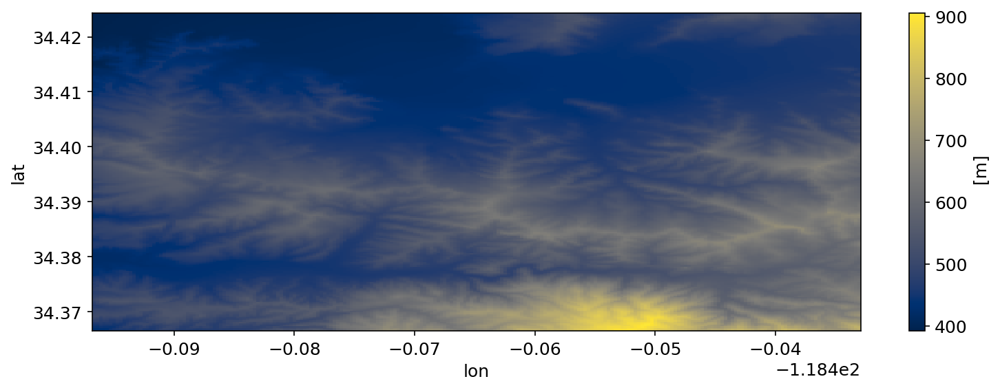

In [ ]:
# download NASA SRTM DEM 1 arc-second
Tiles().download_dem_srtm(AOI, filename=DEM).plot.imshow(cmap='cividis')

## Run Local Dask Cluster

Launch Dask cluster for local and distributed multicore computing. That's possible to process terabyte scale Sentinel-1 SLC datasets on Apple Air 16 GB RAM.

In [ ]:
# simple Dask initialization
if 'client' in globals():
    client.close()
client = Client()
client

INFO:distributed.http.proxy:To route to workers diagnostics web server please install jupyter-server-proxy: python -m pip install jupyter-server-proxy
INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:32991
INFO:distributed.scheduler:  dashboard at:  http://127.0.0.1:8787/status
INFO:distributed.scheduler:Registering Worker plugin shuffle
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:45009'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:38237'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:46533'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:34333'
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:36023', name: 2, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:36023
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:59308
INFO:distributed.scheduler:Regist

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 8,Total memory: 50.99 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:32991,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 8
Started: Just now,Total memory: 50.99 GiB
Comm: tcp://127.0.0.1:33247,Total threads: 2
Dashboard: http://127.0.0.1:46201/status,Memory: 12.75 GiB
Nanny: tcp://127.0.0.1:45009,


## Init

Search recursively for measurement (.tiff) and annotation (.xml) and orbit (.EOF) files in the DATA directory. It can be directory with full unzipped scenes (.SAFE) subdirectories or just a directory with the list of pairs of required .tiff and .xml files (maybe pre-filtered for orbit, polarization and subswath to save disk space). If orbit files and DEM are missed these will be downloaded automatically below.

### Select Original Secenes and Orbits

Use filters to find required subswath, polarization and orbit in original scenes .SAFE directories in the data directory.

In [ ]:
scenes = S1.scan_slc(DATADIR, subswath=SUBSWATH)

In [ ]:
sbas = Stack(WORKDIR, drop_if_exists=True).set_scenes(scenes).set_reference(REFERENCE)
sbas.to_dataframe()

NOTE: auto set reference scene 2021-01-06. You can change it like Stack.set_reference("2022-01-20")


,datetime,orbit,mission,polarization,subswath,datapath,metapath,noisepath,calibpath,orbitpath,geometry
date,,,,,,,,,,,
2021-01-06,2021-01-06 13:52:38,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210106T135238_20210106T135241_036018_043864_D0B4.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210106T135238_20210106T135241_036018_043864_D0B4.SAFE/annota...,None,None,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210319T040939_V20210105T225942_20210107T005942.EOF,"MULTIPOLYGON (((-118.17292 34.49335, -118.21655 34.49958, -118.26423 34.50638, -118.30973 34.512..."
2021-01-18,2021-01-18 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210118T135237_20210118T135240_036193_043E88_5815.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210118T135237_20210118T135240_036193_043E88_5815.SAFE/annota...,None,None,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210207T122351_V20210117T225942_20210119T005942.EOF,"MULTIPOLYGON (((-118.17358 34.49299, -118.21721 34.49922, -118.26489 34.50601, -118.31039 34.512..."
2021-01-30,2021-01-30 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210130T135237_20210130T135240_036368_04449D_30E3.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210130T135237_20210130T135240_036368_04449D_30E3.SAFE/annota...,None,None,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210219T121824_V20210129T225942_20210131T005942.EOF,"MULTIPOLYGON (((-118.17513 34.49361, -118.21875 34.49985, -118.26643 34.50664, -118.31194 34.513..."
2021-02-11,2021-02-11 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210211T135237_20210211T135240_036543_044AAA_DAE0.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210211T135237_20210211T135240_036543_044AAA_DAE0.SAFE/annota...,None,None,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210303T121819_V20210210T225942_20210212T005942.EOF,"MULTIPOLYGON (((-118.17554 34.49288, -118.21916 34.49912, -118.26684 34.50591, -118.31234 34.512..."
2021-02-23,2021-02-23 13:52:36,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210223T135236_20210223T135239_036718_0450C6_883C.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210223T135236_20210223T135239_036718_0450C6_883C.SAFE/annota...,None,None,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210315T122326_V20210222T225942_20210224T005942.EOF,"MULTIPOLYGON (((-118.1741 34.49324, -118.21772 34.49948, -118.2654 34.50627, -118.3109 34.51273,..."
2021-03-07,2021-03-07 13:52:36,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210307T135236_20210307T135239_036893_0456E2_0C1D.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210307T135236_20210307T135239_036893_0456E2_0C1D.SAFE/annota...,None,None,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210327T121833_V20210306T225942_20210308T005942.EOF,"MULTIPOLYGON (((-118.17365 34.49309, -118.21728 34.49933, -118.26495 34.50612, -118.31045 34.512..."
2021-03-19,2021-03-19 13:52:36,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210319T135236_20210319T135239_037068_045CFB_34F9.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210319T135236_20210319T135239_037068_045CFB_34F9.SAFE/annota...,None,None,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210408T121914_V20210318T225942_20210320T005942.EOF,"MULTIPOLYGON (((-118.17341 34.49356, -118.21703 34.4998, -118.2647 34.50659, -118.3102 34.51305,..."
2021-03-31,2021-03-31 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210331T135237_20210331T135240_037243_046307_91F1.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210331T135237_20210331T135240_037243_046307_91F1.SAFE/annota...,None,None,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210420T121836_V20210330T225942_20210401T005942.EOF,"MULTIPOLYGON (((-118.17442 34.49315, -118.21804 34.49939, -118.26571 34.50618, -118.31121 34.512..."
2021-04-12,2021-04-12 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210412T135237_20210412T135240_037418_046911_7DB6.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210412T135237_20210412T135240_037418_046911_7DB6.SAFE/annota...,None,None,data_golden_desc/S1A_OPER_AUX_POEORB_

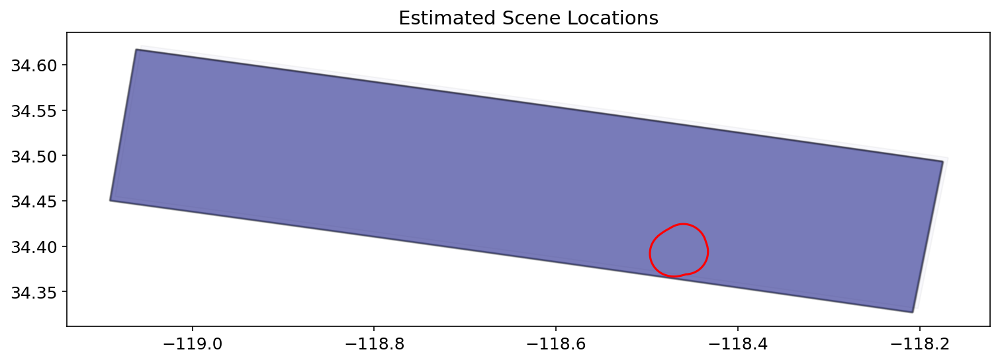

In [ ]:
sbas.plot_scenes(AOI=AOI)

## Reframe Scenes (Optional)

Stitch sequential scenes and crop the subswath to a smaller area for faster processing when the full area is not needed.

In [ ]:
sbas.compute_reframe(AOI)

Reframing: 01...16 from 30:   0%|          | 0/16 [00:00<?, ?it/s]

Reframing: 17...30 from 30:   0%|          | 0/14 [00:00<?, ?it/s]

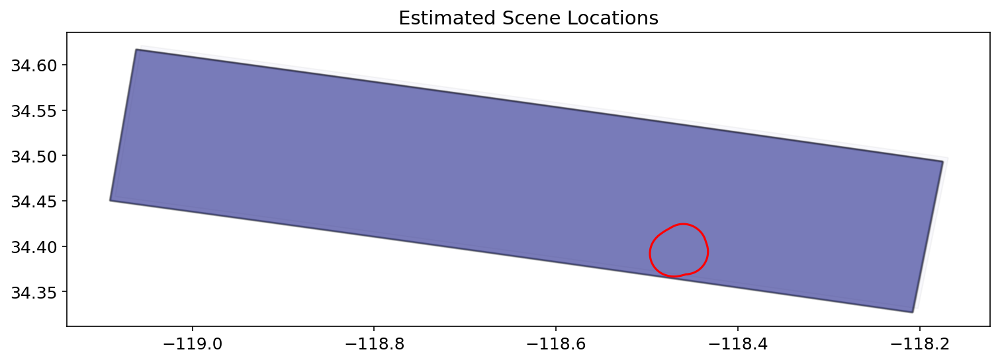

In [ ]:
sbas.plot_scenes(AOI=AOI)

### Load DEM

The function below loads DEM from file or Xarray variable and converts heights to ellipsoidal model using EGM96 grid.

In [ ]:
# define the area of interest (AOI) to speedup the processing
sbas.load_dem(DEM, AOI)

Save DEM on WGS84 Ellipsoid:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-227e938a-b667-11ef-a82f-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:46662


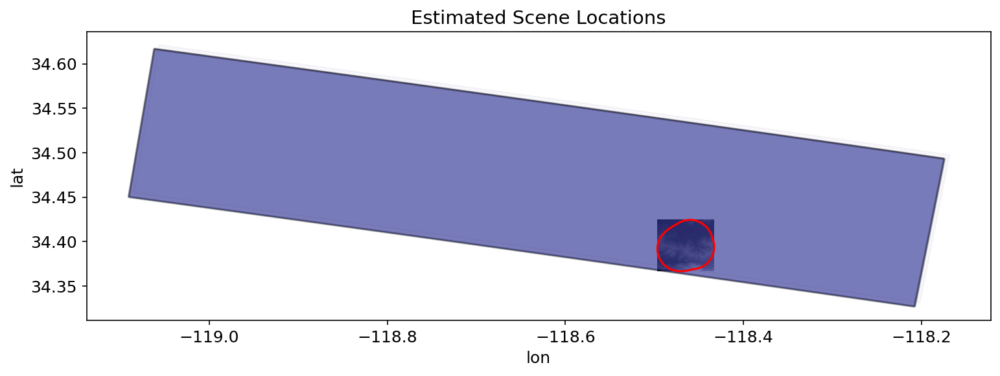

In [ ]:
sbas.plot_scenes(AOI=AOI)

## Align Images

In [ ]:
sbas.compute_align()

Preparing Reference:   0%|          | 0/1 [00:00<?, ?it/s]

Aligning Repeat:   0%|          | 0/29 [00:00<?, ?it/s]

## Geocoding Transform

In [ ]:
# use the original Sentinel-1 resolution (1 pixel spacing)
sbas.compute_geocode(1)

Radar Transform Computing:   0%|          | 0/1 [00:00<?, ?it/s]

Radar Transform Saving:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Transform Indexing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Inverse Transform Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-69061d90-b667-11ef-a832-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:48786
INFO:distributed.scheduler:Receive client connection: Client-worker-6920d2d8-b667-11ef-a82b-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:48812
INFO:distributed.scheduler:Receive client connection: Client-worker-69233149-b667-11ef-a836-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:48828


Satellite Look Vector Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

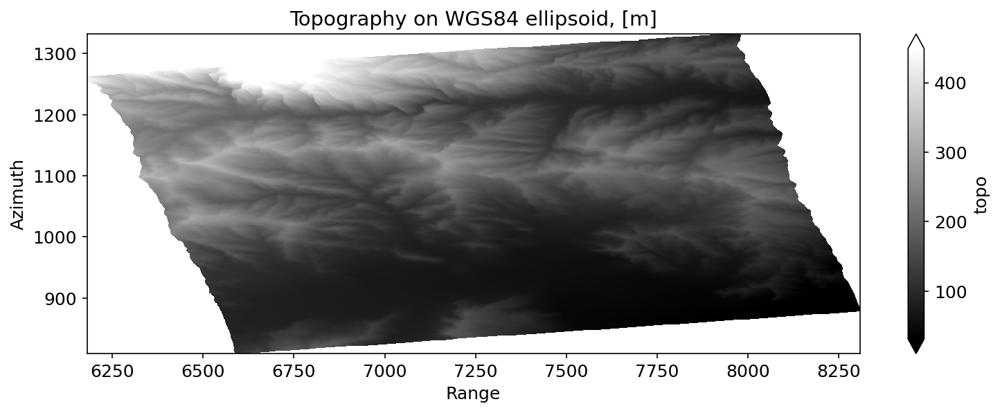

In [ ]:
sbas.plot_topo(quantile=[0.01, 0.99])

## SBAS Baseline

In [ ]:
baseline_pairs = sbas.sbas_pairs(days=24)
# optionally, drop dates having less then 2 pairs
#baseline_pairs = sbas.sbas_pairs_limit(baseline_pairs, limit=2, iterations=2)
# optionally, drop all pairs connected to the specified dates
#baseline_pairs = sbas.sbas_pairs_filter_dates(baseline_pairs, ['2021-01-01'])
baseline_pairs

,ref,rep,ref_baseline,rep_baseline,pair,baseline,duration,rel
0,2021-01-06,2021-01-18,-49.87,-5.14,2021-01-06 2021-01-18,44.73,12,NaT
1,2021-01-06,2021-01-30,-49.87,114.28,2021-01-06 2021-01-30,164.15,24,NaT
2,2021-01-18,2021-01-30,-5.14,114.28,2021-01-18 2021-01-30,119.42,12,NaT
3,2021-01-18,2021-02-11,-5.14,126.08,2021-01-18 2021-02-11,131.22,24,NaT
4,2021-01-30,2021-02-11,114.28,126.08,2021-01-30 2021-02-11,11.80,12,NaT
5,2021-01-30,2021-02-23,114.28,-2.63,2021-01-30 2021-02-23,-116.91,24,NaT
6,2021-02-11,2021-02-23,126.08,-2.63,2021-02-11 2021-02-23,-128.71,12,NaT
7,2021-02-11,2021-03-07,126.08,-61.23,2021-02-11 2021-03-07,-187.31,24,NaT
8,2021-02-23,2021-03-07,-2.63,-61.23,2021-02-23 2021-03-07,-58.60,12,NaT
9,2021-02-23,2021-03-19,-2.63,-93.35,2021-02-23 2021-03-19,-90.72,24,NaT


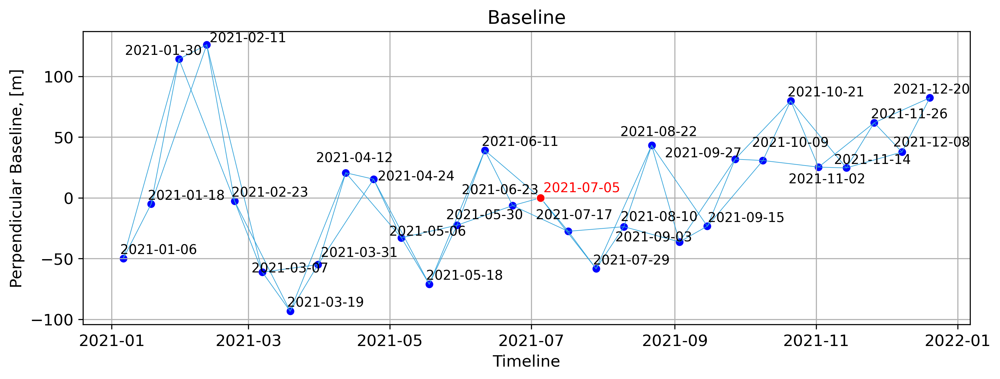

In [ ]:
with mpl_settings({'figure.dpi': 300}):
    sbas.plot_baseline(baseline_pairs)

## Persistent Scatterers Function (PSF)

In [ ]:
# use the only selected dates for the pixels stability analysis
sbas.compute_ps()

Intensity Normalization:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Compute Stability Measures:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

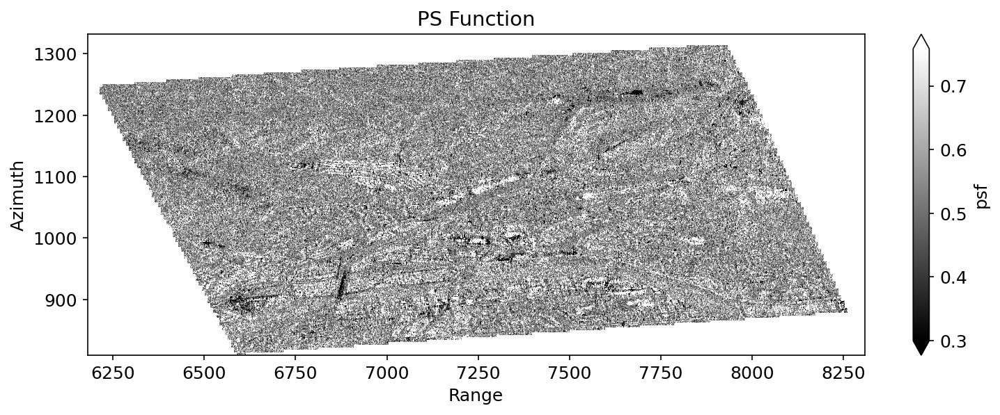

In [ ]:
sbas.plot_psfunction(quantile=[0.01, 0.90])

## PS Analysis

Use the trend detected on possibly lower resolution unwrapped phases for higher resolution analysis.

In [ ]:
sbas.compute_interferogram_singlelook(baseline_pairs, 'intf_slook', wavelength=30, weight=sbas.psfunction())

Saving Interferogram 01...16 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 17...32 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 33...48 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 49...57 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
# optionally, materialize to disk and open
ds_ps = sbas.open_stack('intf_slook')
intf_ps = ds_ps.phase
corr_ps = ds_ps.correlation

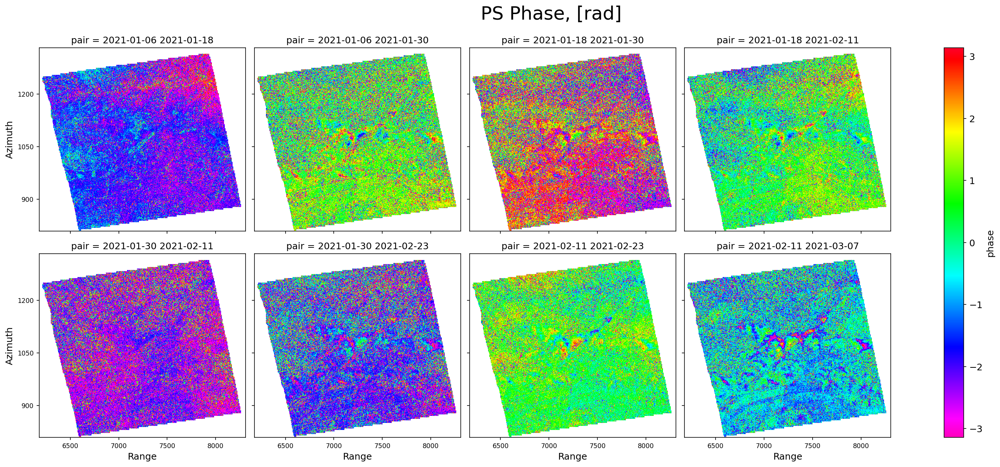

In [ ]:
sbas.plot_interferograms(intf_ps[:8], caption='PS Phase, [rad]')

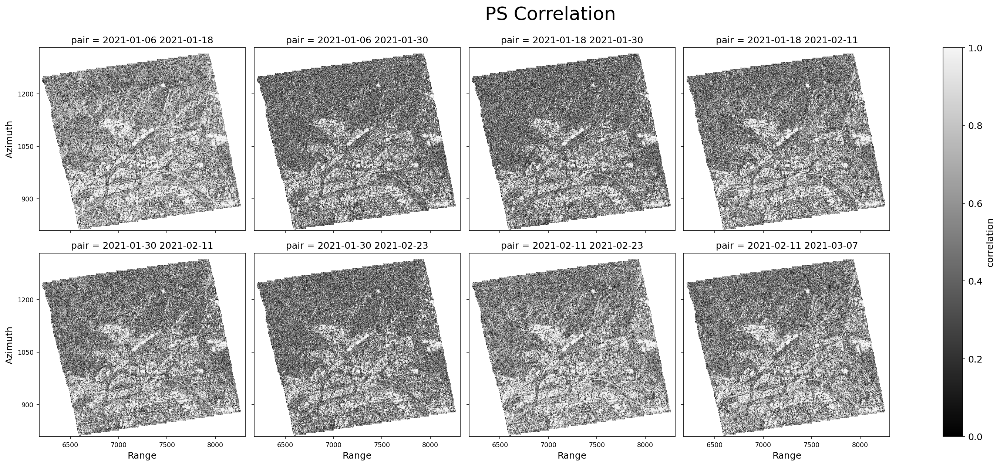

In [ ]:
sbas.plot_correlations(corr_ps[:8], caption='PS Correlation')

## Trend Correction

In [ ]:
topo = sbas.get_topo()
yy, xx = xr.broadcast(topo.y, topo.x)
# use a single tile to prevent border effects
trend_ps = sbas.regression(intf_ps.chunk({'y':9999, 'x':9999}),
        [topo,    topo*yy,    topo*xx,    topo*yy*xx,
         topo**2, topo**2*yy, topo**2*xx, topo**2*yy*xx,
         topo**3, topo**3*yy, topo**3*xx, topo**3*yy*xx,
         yy, xx,
         yy**2, xx**2, yy*xx,
         yy**3, xx**3, yy**2*xx, xx**2*yy], corr_ps, wrap=True)
# optionally, materialize to disk and open
trend_ps = sbas.sync_cube(trend_ps, 'trend_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

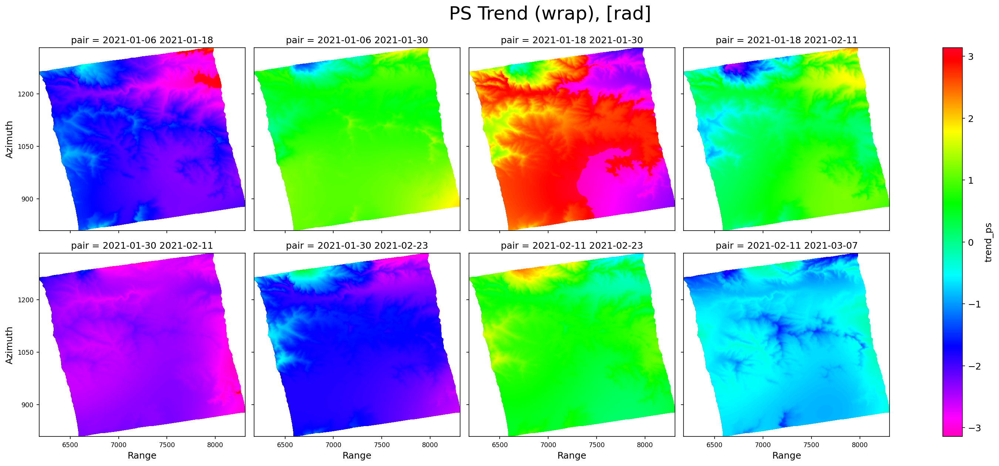

In [ ]:
sbas.plot_interferograms(trend_ps[:8], caption='PS Trend (wrap), [rad]')

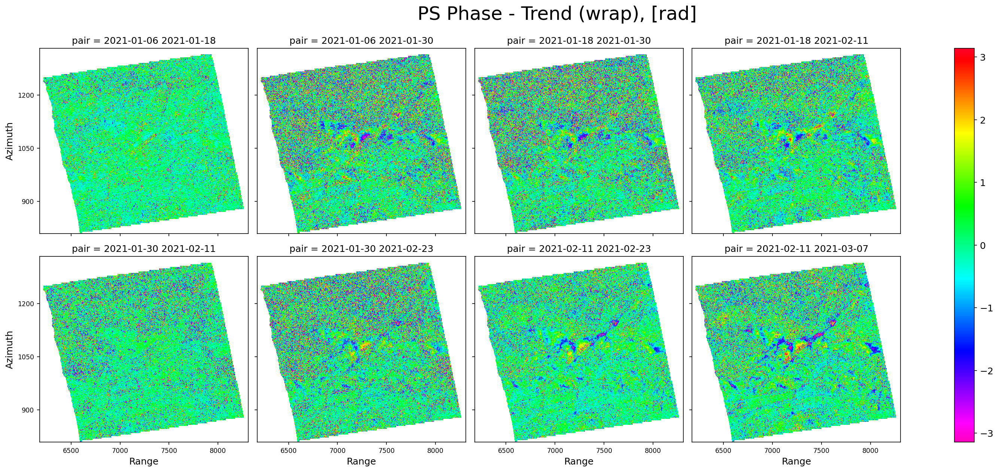

In [ ]:
sbas.plot_interferograms((intf_ps - trend_ps)[:8], caption='PS Phase - Trend (wrap), [rad]')

### 1D Unwrapping and LOS Displacement, mm

In [ ]:
disp_ps_pairs = sbas.los_displacement_mm(sbas.unwrap1d(intf_ps - trend_ps))
disp_ps_pairs

Note: data chunk size (inf, inf) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


<xarray.DataArray 'los' (pair: 57, y: 523, x: 2128)> Size: 254MB
dask.array<mul, shape=(57, 523, 2128), dtype=float32, chunksize=(57, 256, 256), chunktype=numpy.ndarray>
Coordinates:
    ref      (pair) datetime64[ns] 456B dask.array<chunksize=(57,), meta=np.ndarray>
    rep      (pair) datetime64[ns] 456B dask.array<chunksize=(57,), meta=np.ndarray>
  * pair     (pair) <U21 5kB '2021-01-06 2021-01-18' ... '2021-12-08 2021-12-20'
  * y        (y) float64 4kB 809.5 810.5 811.5 ... 1.33e+03 1.33e+03 1.332e+03
  * x        (x) float64 17kB 6.18e+03 6.182e+03 ... 8.306e+03 8.308e+03

In [ ]:
# optionally, materialize to disk and open
disp_ps_pairs = sbas.sync_cube(disp_ps_pairs, 'disp_ps_pairs')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

### Coherence-Weighted Least-Squares Solution for LOS Displacement, mm

In [ ]:
disp_ps = sbas.lstsq(disp_ps_pairs, corr_ps)
disp_ps

Note: data chunk size (inf, inf) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


<xarray.DataArray 'displacement' (date: 30, y: 523, x: 2128)> Size: 134MB
dask.array<concatenate, shape=(30, 523, 2128), dtype=float32, chunksize=(30, 256, 256), chunktype=numpy.ndarray>
Coordinates:
  * date     (date) datetime64[ns] 240B 2021-01-06 2021-01-18 ... 2021-12-20
  * y        (y) float64 4kB 809.5 810.5 811.5 ... 1.33e+03 1.33e+03 1.332e+03
  * x        (x) float64 17kB 6.18e+03 6.182e+03 ... 8.306e+03 8.308e+03

In [ ]:
# optionally, materialize to disk and open
disp_ps = sbas.sync_cube(disp_ps, 'disp_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

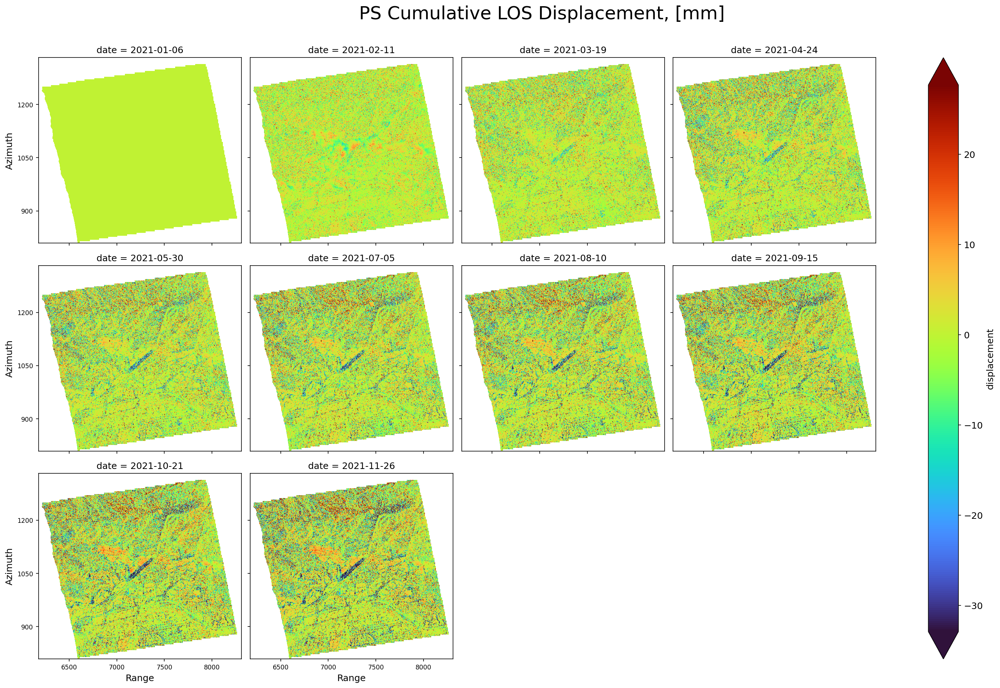

In [ ]:
zmin, zmax = np.nanquantile(disp_ps, [0.01, 0.99])
sbas.plot_displacements(disp_ps[::3], caption='PS Cumulative LOS Displacement, [mm]', vmin=zmin, vmax=zmax)

### Least-squares model for LOS Displacement, mm

In [ ]:
velocity_ps = sbas.velocity(disp_ps)
velocity_ps

<xarray.DataArray 'trend' (y: 523, x: 2128)> Size: 4MB
dask.array<mul, shape=(523, 2128), dtype=float32, chunksize=(262, 2128), chunktype=numpy.ndarray>
Coordinates:
  * y        (y) float64 4kB 809.5 810.5 811.5 ... 1.33e+03 1.33e+03 1.332e+03
  * x        (x) float64 17kB 6.18e+03 6.182e+03 ... 8.306e+03 8.308e+03
    degree   int64 8B 1

In [ ]:
# optionally, materialize to disk and open
velocity_ps = sbas.sync_cube(velocity_ps, 'velocity_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

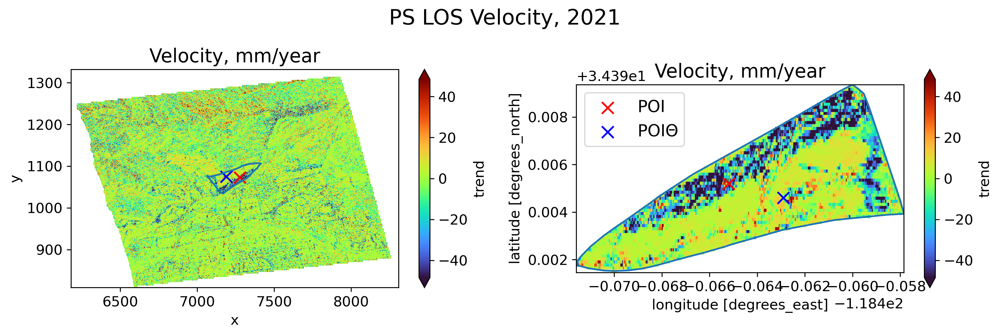

In [ ]:
fig = plt.figure(figsize=(12,4), dpi=300)

zmin, zmax = np.nanquantile(velocity_ps, [0.01, 0.99])
zminmax = max(abs(zmin), zmax)

ax = fig.add_subplot(1, 2, 1)
velocity_ps.plot.imshow(cmap='turbo', vmin=-zminmax, vmax=zminmax, ax=ax)
sbas.geocode(AOI.buffer(-BUFFER).boundary).plot(ax=ax)
sbas.geocode(POI).plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
sbas.geocode(POI0).plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.set_aspect('auto')
ax.set_title('Velocity, mm/year', fontsize=16)

ax = fig.add_subplot(1, 2, 2)
sbas.as_geo(sbas.ra2ll(velocity_ps)).rio.clip(AOI.geometry.buffer(-BUFFER))\
    .plot.imshow(cmap='turbo', vmin=-zminmax, vmax=zminmax, ax=ax)
AOI.buffer(-BUFFER).boundary.plot(ax=ax)
POI.plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
POI0.plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.legend(loc='upper left', fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

plt.suptitle('PS LOS Velocity, 2021', fontsize=18)
plt.tight_layout()
plt.show()

### STL model for LOS Displacement, mm

Note: data chunk size (inf, inf) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)
Note: data chunk size (inf, inf) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


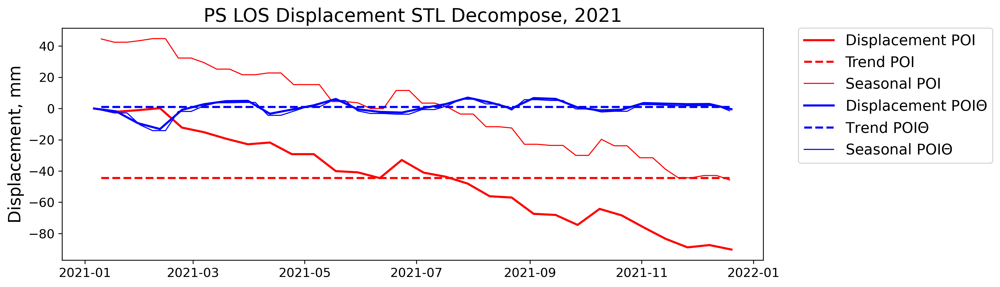

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)

x, y = [(geom.x, geom.y) for geom in sbas.geocode(POI).geometry][0]
disp_pixel = disp_ps.sel(y=y, x=x, method='nearest')
stl_pixel = sbas.stl(disp_ps.sel(y=[y], x=[x], method='nearest')).isel(x=0, y=0)
plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')
plt.plot(stl_pixel.date, stl_pixel.trend, c='r', ls='--', lw=2, label='Trend POI')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='r', lw=1, label='Seasonal POI')

x, y = [(geom.x, geom.y) for geom in sbas.geocode(POI0).geometry][0]
disp_pixel = disp_ps.sel(y=y, x=x, method='nearest')
stl_pixel = sbas.stl(disp_ps.sel(y=[y], x=[x], method='nearest')).isel(x=0, y=0)
plt.plot(disp_pixel.date, disp_pixel, c='b', lw=2, label='Displacement POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.trend, c='b', ls='--', lw=2, label='Trend POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='b', lw=1, label='Seasonal POI$\Theta$')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=14)
plt.title('PS LOS Displacement STL Decompose, 2021', fontsize=18)
plt.ylabel('Displacement, mm', fontsize=16)
plt.show()

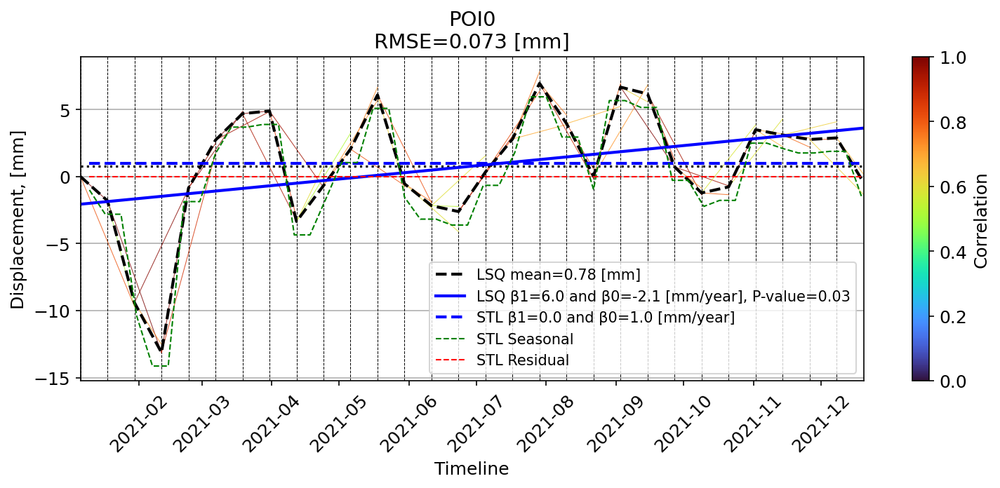

In [ ]:
x, y = [(geom.x, geom.y) for geom in sbas.geocode(POI0).geometry][0]
sbas.plot_baseline_displacement_los_mm(disp_ps_pairs.sel(y=y, x=x, method='nearest')/sbas.los_displacement_mm(1),
                                corr_ps.sel(y=y, x=x, method='nearest'),
                               caption='POI0', stl=True)

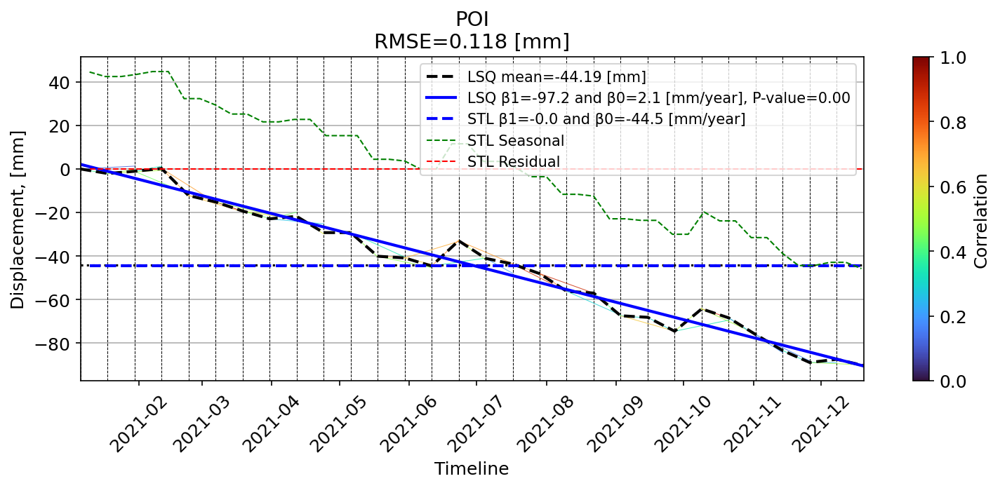

In [ ]:
x, y = [(geom.x, geom.y) for geom in sbas.geocode(POI).geometry][0]
sbas.plot_baseline_displacement_los_mm(disp_ps_pairs.sel(y=y, x=x, method='nearest')/sbas.los_displacement_mm(1),
                                corr_ps.sel(y=y, x=x, method='nearest'),
                               caption='POI', stl=True)

### RMSE Error Estimation

In [ ]:
rmse_ps = sbas.rmse(disp_ps_pairs, disp_ps, corr_ps)
rmse_ps

<xarray.DataArray 'rmse' (y: 523, x: 2128)> Size: 4MB
dask.array<sqrt, shape=(523, 2128), dtype=float32, chunksize=(523, 2048), chunktype=numpy.ndarray>
Coordinates:
  * y        (y) float64 4kB 809.5 810.5 811.5 ... 1.33e+03 1.33e+03 1.332e+03
  * x        (x) float64 17kB 6.18e+03 6.182e+03 ... 8.306e+03 8.308e+03

In [ ]:
# optionally, materialize to disk and open
rmse_ps = sbas.sync_cube(rmse_ps, 'rmse_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

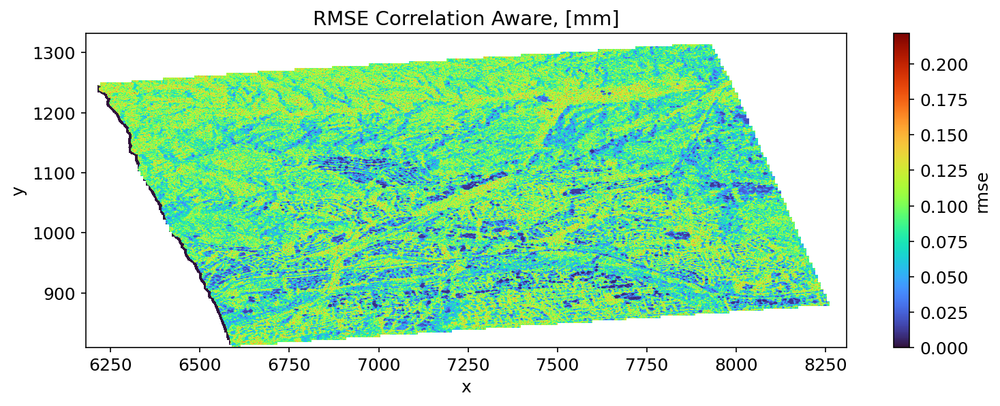

In [ ]:
sbas.plot_rmse(rmse_ps, caption='RMSE Correlation Aware, [mm]')